In [2]:
%matplotlib inline
import numpy as np, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display

In [90]:
piano, psr = librosa.load('piano.mp3', duration=60, offset=.48)
guitar, gsr = librosa.load('guitar.mp3', duration=60, offset=.3)
ipd.Audio(piano, rate=psr)

In [27]:
ipd.Audio(guitar, rate=gsr)

In [3]:
def init1():
    plt.style.use('seaborn-muted')
    plt.rcParams['figure.figsize'] = (14, 5)
    plt.rcParams['axes.grid'] = True
    plt.rcParams['axes.spines.left'] = False
    plt.rcParams['axes.spines.right'] = False
    plt.rcParams['axes.spines.bottom'] = False
    plt.rcParams['axes.spines.top'] = False
    plt.rcParams['axes.xmargin'] = 0
    plt.rcParams['axes.ymargin'] = 0
    plt.rcParams['image.cmap'] = 'gray'
    plt.rcParams['image.interpolation'] = None
    
def init2():
    plt.style.use('dark_background')
    plt.rcParams['axes.grid'] = True
    plt.rcParams['grid.color'] = '#81c1b6'
    plt.rcParams['grid.alpha'] = .5
    plt.rcParams['grid.linestyle'] = 'dashed'
    plt.rcParams['axes.spines.left'] = False
    plt.rcParams['axes.spines.right'] = False
    plt.rcParams['axes.spines.top'] = False
    plt.rcParams['axes.spines.bottom'] = False
    plt.rcParams['figure.figsize'] = (16, 8)

In [4]:
init1()

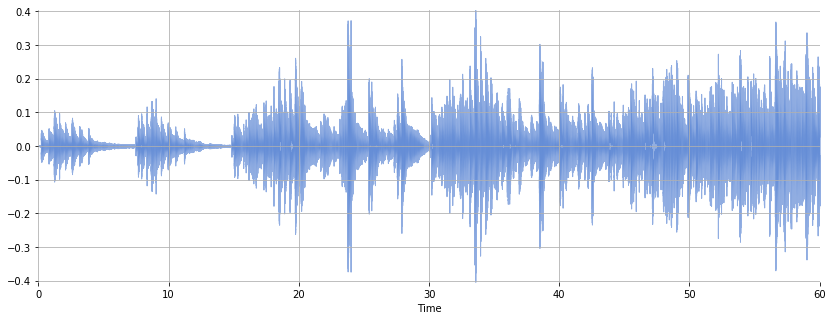

In [28]:
librosa.display.waveplot(piano, psr, alpha=.6)

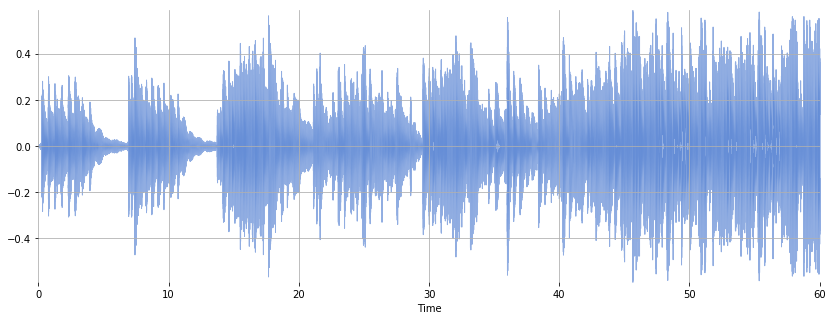

In [29]:
librosa.display.waveplot(guitar, gsr, alpha=.6)

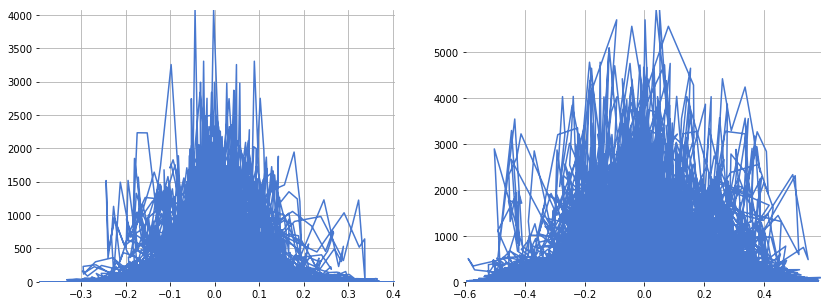

In [30]:
p_fft = np.absolute(scipy.fft(piano))
g_fft = np.absolute(scipy.fft(guitar))
plt.subplot(121)
plt.plot(piano, p_fft)
plt.subplot(122)
plt.plot(guitar, g_fft)

C:\Users\Bojo\Anaconda3\lib\site-packages\librosa\core\spectrum.py:958: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(magphase(D)[0]) instead.
  warnings.warn('amplitude_to_db was called on complex input so phase '


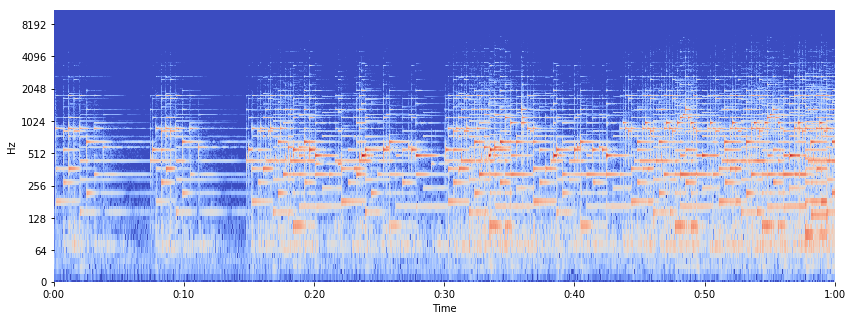

In [31]:
piano_stft = librosa.stft(piano)
librosa.display.specshow(librosa.core.amplitude_to_db(piano_stft), sr=psr, x_axis='time', y_axis='log')

C:\Users\Bojo\Anaconda3\lib\site-packages\librosa\core\spectrum.py:958: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(magphase(D)[0]) instead.
  warnings.warn('amplitude_to_db was called on complex input so phase '


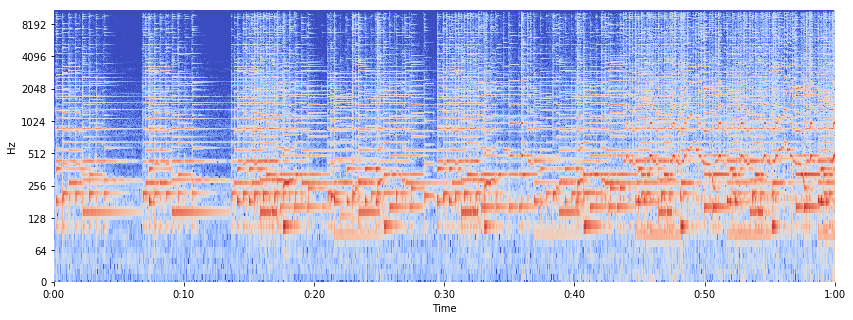

In [32]:
guitar_stft = librosa.stft(guitar)
librosa.display.specshow(librosa.core.amplitude_to_db(guitar_stft), sr=psr, x_axis='time', y_axis='log')

In [48]:
timestamps = np.arange(0, 60, 10)
#print(timestamps)
ps = librosa.core.time_to_samples(timestamps)
gs = librosa.core.time_to_samples(timestamps)
#print(ps)
piano_samples = [piano[ps[i]: ps[i+1]] for i in np.arange(0, len(timestamps) -1)]
guitar_samples = [guitar[ps[i]: ps[i+1]] for i in np.arange(0, len(timestamps) -1)]
#print(piano_samples)
#ipd.Audio(piano_samples[2], rate=psr)

C:\Users\Bojo\Anaconda3\lib\site-packages\matplotlib\cbook\deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


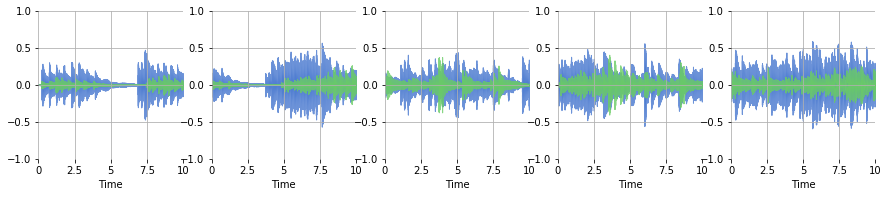

In [62]:
plt.figure(figsize=(15, 6))
for i, x in enumerate(guitar_samples):
    plt.subplot(2, 5, i+1)
    librosa.display.waveplot(x, alpha=.8)
    plt.ylim(-1, 1)
for i, x in enumerate(piano_samples):
    plt.subplot(2, 5, i+1)
    librosa.display.waveplot(x, alpha=.8)
    plt.ylim(-1, 1)

In [64]:
piano_zcr = [np.sum(librosa.core.zero_crossings(x)) for x in piano_samples]
guitar_zcr = [np.sum(librosa.core.zero_crossings(x)) for x in guitar_samples]
print(piano_zcr, guitar_zcr)

[11637, 10969, 9694, 11855, 12936] [15776, 16738, 13986, 20436, 25918]


In [65]:
librosa.feature.spectral_centroid(piano_samples[0])

array([[1972.33321864, 1659.20279329, 1991.4002524 , 2175.98010509,
        2232.55157881, 2433.89406049, 2433.57961607, 1170.1090795 ,
         926.31786998,  778.02580215,  728.94880799,  753.79330165,
         735.16092655,  716.64595911,  705.568688  ,  712.40292554,
         710.43247584,  707.06753375,  698.35591867,  663.78138555,
         655.21492163,  637.86883213,  660.94410481,  670.56759206,
         686.92795717,  702.84594255,  704.58161171,  707.72447746,
         710.40730757,  693.67423656,  692.06470918,  693.90900889,
         750.10283459,  765.53240253,  685.14161143,  587.08212903,
         565.99683309,  557.90955677,  562.48962825,  569.22366075,
         588.06194499,  592.94998669,  611.83091881,  630.73369272,
         642.49836582,  649.47796176,  656.71206117,  653.02397582,
         636.07002996,  617.90750191,  839.24111733,  838.91053617,
         759.35882628,  698.79182815,  698.46119625,  727.99291464,
         721.91379775,  724.03290928,  726.41045

In [69]:
piano_frames = librosa.util.frame(piano, frame_length=1024, hop_length=512)
guitar_frames = librosa.util.frame(guitar, frame_length=1024, hop_length=512)

In [72]:
print(piano_frames.shape, guitar_frames.shape)

(1024, 2582) (1024, 2582)


In [6]:
def rmse(signal):
    return np.sqrt(np.mean(signal**2))

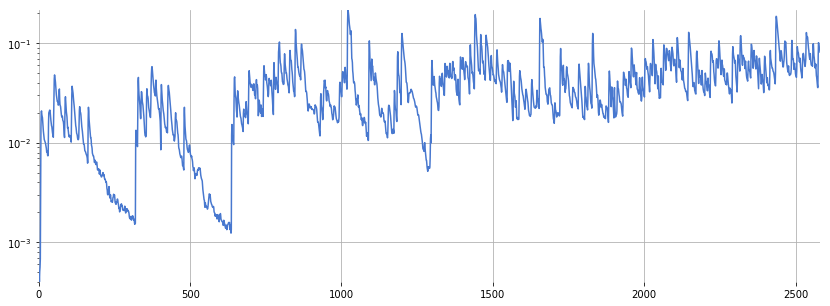

In [74]:
plt.semilogy([rmse(frame) for frame in piano_frames.T])

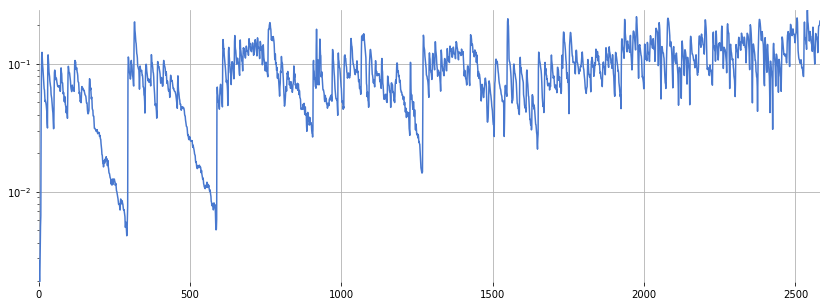

In [75]:
plt.semilogy([rmse(frame) for frame in guitar_frames.T])

In [85]:
piano, psr = librosa.load('piano.mp3')

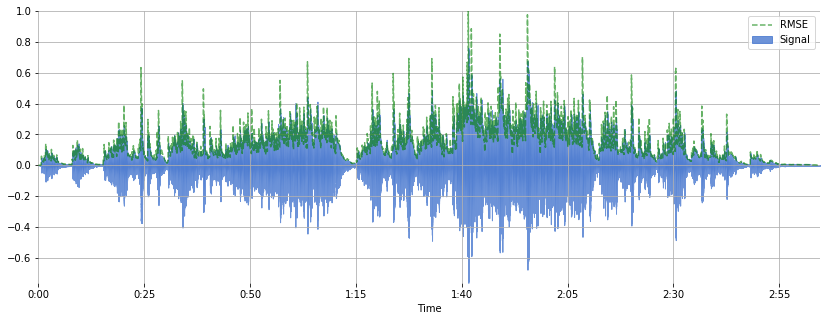

In [86]:
rmse = librosa.feature.rmse(piano, frame_length=1024, hop_length=512)[0]
t = librosa.core.frames_to_time(range(rmse.shape[0]), sr=psr, hop_length=512)
librosa.display.waveplot(piano, sr=psr, alpha=0.8)
plt.plot(t[:len(rmse)], rmse/rmse.max(), 'g--', alpha=.6) # normalized for visualization
plt.legend(('RMSE', 'Signal'))

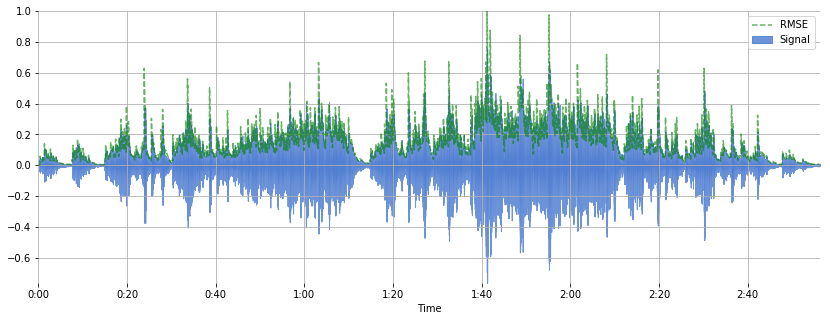

In [150]:
rmse = librosa.feature.rmse(piano2, frame_length=1024, hop_length=512)[0]
t = librosa.core.frames_to_time(range(rmse.shape[0]), sr=psr, hop_length=512)
librosa.display.waveplot(piano2, sr=psr, alpha=0.8)
plt.plot(t[:len(rmse)], rmse/rmse.max(), 'g--', alpha=.6) # normalized for visualization
plt.legend(('RMSE', 'Signal'))

In [14]:
print(rmse.shape)
print(piano.shape[0] / 1024)

(7949,)
3974.0625


In [101]:
print(rmse[:-1200])

[0.         0.         0.         ... 0.0191827  0.07426527 0.12381607]


In [15]:
np.flipud(np.cumsum(np.flipud(rmse)))[3000]

265.2334

In [16]:
hop = 256
frame = 1024

In [147]:
def strip(signal, st=1e-7, et=.9):
    hop = 256
    frame = 1024
    frames = librosa.util.frame(signal, hop_length=hop, frame_length=frame)
    rmse = np.array([np.sqrt(np.mean(x**2)) for x in frames.T])
    brmse = np.array([np.sum(rmse[:i]) for i in range(len(rmse))])
    ermse = np.array([np.sum(rmse[i:]) for i in range(len(rmse))])
    start_frame = np.where(brmse < st)[0][::-1][0]
    end_frame = np.where(ermse < et)[0][0]
    samples = librosa.frames_to_samples([start_frame, end_frame], hop_length=hop)
    return signal[samples[0]:samples[1]]

In [153]:
guitar, gsr = librosa.load('guitar.mp3')
piano2 = strip(piano)
guitar2 = strip(guitar)

In [154]:
ipd.Audio(guitar2, rate=psr)

In [155]:
ipd.Audio(guitar, rate=psr)